In [1]:
%load_ext autoreload
%autoreload 2
exec(open('init_notebook.py').read())
from highD.Visualizer import Visualizer
from highD.notebook_helper import *

current working dirC:\Users\abjaw\Documents\GitHub\CogMod-driver-behavior-model\highd_tools


In [2]:
# ids = ["01", "02", "03", "04", "05", "06", "07", "08", "09", "10", "11", "12", "13", "14", "15", "16", "17", "18", "19", "20", 
#        "21", "22", "23", "24", "25", "26", "27", "28", "29", "30", "31", "32", "33", "34", "35", "36", "37", "38", "39", "40",
#        "41", "42", "43", "44", "45", "46", "47", "48", "49", "50", "51", "52", "53", "54", "55", "56", "57", "58", "59", "60",] 
ids = ["01", "02"]
dfs, images = get_data_and_images(ids, DATA_DIRECTORY)

length df1, df2, df3 1, 1047, 348750
length df1, df2, df3 1, 1113, 378115


In [3]:
dataset_id = 1
df_tuple = dfs[dataset_id]
image = images[dataset_id]
rMeta, tMeta, tracks = df_tuple
tMeta.head()

,id,width,height,initialFrame,finalFrame,numFrames,class,drivingDirection,traveledDistance,minXVelocity,maxXVelocity,meanXVelocity,minDHW,minTHW,minTTC,numLaneChanges
0,1,4.14,1.82,1,98,98,Car,2,163.45,41.68,42.62,42.20,-1.00,-1.00,-1.0,0
1,2,4.65,2.02,1,164,164,Car,2,216.62,32.82,33.60,33.26,33.05,0.99,-1.0,0
2,3,14.45,2.50,1,183,183,Truck,1,173.88,23.86,23.97,23.90,-1.00,-1.00,-1.0,0
3,4,4.85,2.02,1,272,272,Car,1,387.66,34.61,36.38,35.78,-1.00,-1.00,-1.0,0
4,5,4.85,2.02,2,116,115,Car,2,190.27,40.68,42.48,41.80,30.98,0.76,-1.0,1


In [5]:
def filter_by_ttc(tracks, tMeta, ego_type, preceding_type, ttc_lower_bound=0, ttc_upper_bound=6, min_duration=-1):
    car_following_meta = {'ego_id': [], 'preceding_id': [],
                          'start_frame': [], 'end_frame': []}

    all_ego_agent_id = set(tMeta[(tMeta['class'] == ego_type) & (tMeta['numLaneChanges'] == 0)]['id'].tolist())
    all_preceding_agent_id = set(tMeta[(tMeta['class'] == preceding_type) & (tMeta['numLaneChanges'] == 0)]['id'].tolist())

    frame_threshold = 25 * min_duration if min_duration != -1 else 2

    for ego_id in all_ego_agent_id:
        all_frames_with_agent = tracks[(tracks['id'] == ego_id)]
        unique_preceding_agent_list = list((set(all_frames_with_agent['precedingId'].unique()) & all_preceding_agent_id))

        for preceding_id in unique_preceding_agent_list:
            vehicle_follow_frames = all_frames_with_agent[all_frames_with_agent['precedingId'] == preceding_id]
            min_ttc, max_ttc = vehicle_follow_frames['ttc'].min(), vehicle_follow_frames['ttc'].max()

            if ttc_lower_bound < min_ttc <= ttc_upper_bound and len(vehicle_follow_frames) >= frame_threshold:
                car_following_meta['ego_id'].append(ego_id)
                car_following_meta['preceding_id'].append(preceding_id)
                car_following_meta['start_frame'].append(
                    vehicle_follow_frames['frame'].iloc[0])
                car_following_meta['end_frame'].append(
                    vehicle_follow_frames['frame'].iloc[-1])

    return car_following_meta


In [6]:
ttc_lower_bound=0 
ttc_upper_bound=5
min_duration=1

car_following_meta = filter_by_ttc(tracks, tMeta, 'Car', 'Car',
                                                 ttc_lower_bound=ttc_lower_bound, 
                                                 ttc_upper_bound=ttc_upper_bound,
                                                 min_duration=min_duration)

car_following_meta_df = pd.DataFrame(car_following_meta)
print(car_following_meta_df.shape)
car_following_meta_df.head()

(1, 4)


,ego_id,preceding_id,start_frame,end_frame
0,509,500,11349,11510


start: 11215, end: 11554 


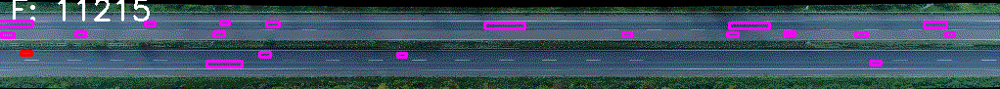

In [8]:
scenario_id = 0
gif_name = Visualizer.create_gif_for_agent_with_target(images[dataset_id],
                                                       tracks,
                                                       tMeta,
                                                       agent_id=car_following_meta_df.iloc[scenario_id]['ego_id'],
                                                       target_id=car_following_meta_df.iloc[scenario_id]['preceding_id'],
                                                       fps=25,
                                                       output_dir=OUTPUT_DIRECTORY)
display_animated_gif(os.path.join(OUTPUT_DIRECTORY, gif_name))

In [ ]:
# def plot_ego_ttc_thw_dhw_normalized(tracks, follow_meta, cMin, cMax, buffer_percent=0.05):
#     ego_id, preceding_id, start_frame, end_frame = follow_meta[['ego_id', 'preceding_id', 'start_frame', 'end_frame']]
    
#     ego_tracks = tracks.loc[(tracks['id'] == ego_id) & (tracks['frame'] >= start_frame) & (tracks['frame'] < end_frame)]
#     preceding_tracks = tracks.loc[(tracks['id'] == preceding_id) & (tracks['frame'] >= start_frame) & (tracks['frame'] < end_frame)]
    
#     ttc_ego, thw_ego, dhw_ego = [np.clip(arr, cMin, cMax) for arr in ego_tracks[['ttc', 'thw', 'dhw']].values.T]
#     ego_xvelocity, preceding_xvelocity = np.abs(ego_tracks['xVelocity'].values), np.abs(preceding_tracks['xVelocity'].values)

#     fig, axs = plt.subplots(5, 1, figsize=(30, 25), sharex=True)
#     fig.suptitle(f'TTC, THW, and DHW for Ego Vehicle (ID: {ego_id})')

#     # Velocity Preceding Velocity Ego  
#     axs[0].plot(ego_tracks['frame'], ego_xvelocity, label='Velocity Ego')
#     axs[0].legend()
#     axs[0].plot(ego_tracks['frame'], preceding_xvelocity, label='Velocity Preceding')
#     axs[0].legend()

#     # TTC
#     axs[1].plot(ego_tracks['frame'], ttc_ego, label='TTC')
#     axs[1].legend()

#     # THW
#     axs[2].plot(ego_tracks['frame'], thw_ego, label='THW')
#     axs[2].legend()

#     # DHW
#     axs[3].plot(ego_tracks['frame'], dhw_ego, label='DHW')
#     axs[3].legend()

#     # Normalized
#     axs[4].plot(ego_tracks['frame'], ttc_ego/np.linalg.norm(ttc_ego), label='Normalized TTC')
#     axs[4].plot(ego_tracks['frame'], thw_ego/np.linalg.norm(thw_ego), label='Normalized THW')
#     axs[4].plot(ego_tracks['frame'], dhw_ego/np.linalg.norm(dhw_ego), label='Normalized DHW')
#     axs[4].legend()

#     for idx in range(5):
#         min_y, max_y = axs[idx].get_ylim()
#         y_range = max_y - min_y
#         buffer = y_range * buffer_percent
#         axs[idx].set_ylim(min_y - buffer, max_y + buffer)

#     plt.show()

# plot_ego_ttc_thw_dhw_normalized(tracks, car_following_meta_df.iloc[scenario_id], -100, 100)


In [17]:
print(tracks.columns)
print(tMeta.columns)

def calculate_ttc(df):
    # Extract required information from the DataFrame
    x_lead = df['x'] - df['width']
    x_follow = df['x']
    lead_length = df['width']
    v_lead = df['precedingXVelocity']
    v_follow = df['xVelocity']

    # Calculate the numerator and denominator of the TTC formula
    numerator = x_lead - x_follow - lead_length
    denominator = v_follow - v_lead

    # Avoid division by zero by replacing zeros in the denominator with a small value
    denominator = np.where(denominator == 0, 1e-9, denominator)

    # Calculate TTC
    ttc = numerator / denominator

    return ttc

combined_tracks = pd.merge(tracks, tMeta[['id', 'class', 'drivingDirection']], on='id')
print(combined_tracks.columns)
tracks_df = combined_tracks.copy()
tracks_df['calculated_ttc'] = calculate_ttc(tracks_df)
tracks_df.head()

Index(['frame', 'id', 'x', 'y', 'width', 'height', 'xVelocity', 'yVelocity',
       'xAcceleration', 'yAcceleration', 'frontSightDistance',
       'backSightDistance', 'dhw', 'thw', 'ttc', 'precedingXVelocity',
       'precedingId', 'followingId', 'leftPrecedingId', 'leftAlongsideId',
       'leftFollowingId', 'rightPrecedingId', 'rightAlongsideId',
       'rightFollowingId', 'laneId'],
      dtype='object')
Index(['id', 'width', 'height', 'initialFrame', 'finalFrame', 'numFrames',
       'class', 'drivingDirection', 'traveledDistance', 'minXVelocity',
       'maxXVelocity', 'meanXVelocity', 'minDHW', 'minTHW', 'minTTC',
       'numLaneChanges'],
      dtype='object')
Index(['frame', 'id', 'x', 'y', 'width', 'height', 'xVelocity', 'yVelocity',
       'xAcceleration', 'yAcceleration', 'frontSightDistance',
       'backSightDistance', 'dhw', 'thw', 'ttc', 'precedingXVelocity',
       'precedingId', 'followingId', 'leftPrecedingId', 'leftAlongsideId',
       'leftFollowingId', 'rightPrece

,frame,id,x,y,width,height,xVelocity,yVelocity,xAcceleration,yAcceleration,...,leftPrecedingId,leftAlongsideId,leftFollowingId,rightPrecedingId,rightAlongsideId,rightFollowingId,laneId,class,drivingDirection,calculated_ttc
0,1,1,249.91,22.62,4.14,1.82,41.68,-0.18,0.27,0.00,...,0,0,0,0,0,2,5,Car,2,-0.198656
1,2,1,251.43,22.62,4.14,1.82,41.69,-0.18,0.27,0.01,...,0,0,0,0,0,2,5,Car,2,-0.198609
2,3,1,253.01,22.61,4.14,1.82,41.70,-0.18,0.28,0.01,...,0,0,0,0,0,2,5,Car,2,-0.198561
3,4,1,254.62,22.60,4.14,1.82,41.71,-0.18,0.28,0.01,...,0,0,0,0,0,2,5,Car,2,-0.198514
4,5,1,256.25,22.59,4.14,1.82,41.73,-0.18,0.29,0.01,...,0,0,0,0,0,2,5,Car,2,-0.198418


In [ ]:
# ttc_lower_bound=0 
# ttc_upper_bound=5
# min_duration=1
# car_following_scenarios = {}

# for dataset_id in range(len(dfs)):
#     df_tuple = dfs[dataset_id]
#     rMeta, tMeta, tracks = df_tuple

#     car_following_meta = find_vehicle_following_meta(tracks, tMeta, 'Car', 'Car',
#                                                       ttc_lower_bound=ttc_lower_bound, 
#                                                       ttc_upper_bound=ttc_upper_bound,
#                                                       min_duration=min_duration)

#     car_following_meta_df = pd.DataFrame(car_following_meta)
#     car_following_scenarios[dataset_id] = car_following_meta_df

# # Print the car_following_meta_df for each dataset_id
# for dataset_id, car_following_meta_df in car_following_scenarios.items():
#     print(f"Dataset ID: {dataset_id}")
#     print(car_following_meta_df.shape)
#     print(car_following_meta_df.head())
#     print("\n")


In [ ]:

# for dataset_id, car_following_meta_df in car_following_scenarios.items():
#     print(f"Dataset ID: {dataset_id}")
#     rMeta, tMeta, tracks = dfs[dataset_id]
#     image = images[dataset_id]
#     for i in range(len(car_following_meta_df)):
#         gif_name = Visualizer.create_gif_for_agent_with_target(image,
#                                                                tracks,
#                                                                tMeta,
#                                                                agent_id=car_following_meta_df.iloc[i]['ego_id'],
#                                                                target_id=car_following_meta_df.iloc[i]['preceding_id'],
#                                                                fps=25,
#                                                                output_dir=OUTPUT_DIRECTORY)
#         display_animated_gif(os.path.join(OUTPUT_DIRECTORY, gif_name))

In [ ]:
# car_following_scenarios.values()